### Temperature Forecast Project using ML
#### Problem Statement:
##### Data Set Information:

    This data is for the purpose of bias correction of next-day maximum and minimum air temperatures forecast of the LDAPS model operated by the Korea Meteorological Administration over Seoul, South Korea. This data consists of summer data from 2013 to 2017. The input data is largely composed of the LDAPS model's next-day forecast data, in-situ maximum and minimum temperatures of present-day, and geographic auxiliary variables. There are two outputs (i.e. next-day maximum and minimum air temperatures) in this data. Hindcast validation was conducted for the period from 2015 to 2017.


    Attribute Information:

    For more information, read [Cho et al, 2020].
    1. station - used weather station number: 1 to 25
    2. Date - Present day: yyyy-mm-dd ('2013-06-30' to '2017-08-30')
    3. Present_Tmax - Maximum air temperature between 0 and 21 h on the present day (Â°C): 20 to 37.6
    4. Present_Tmin - Minimum air temperature between 0 and 21 h on the present day (Â°C): 11.3 to 29.9
    5. LDAPS_RHmin - LDAPS model forecast of next-day minimum relative humidity (%): 19.8 to 98.5
    6. LDAPS_RHmax - LDAPS model forecast of next-day maximum relative humidity (%): 58.9 to 100
    7. LDAPS_Tmax_lapse - LDAPS model forecast of next-day maximum air temperature applied lapse rate (Â°C): 17.6 to 38.5
    8. LDAPS_Tmin_lapse - LDAPS model forecast of next-day minimum air temperature applied lapse rate (Â°C): 14.3 to 29.6
    9. LDAPS_WS - LDAPS model forecast of next-day average wind speed (m/s): 2.9 to 21.9
    10. LDAPS_LH - LDAPS model forecast of next-day average latent heat flux (W/m2): -13.6 to 213.4
    11. LDAPS_CC1 - LDAPS model forecast of next-day 1st 6-hour split average cloud cover (0-5 h) (%): 0 to 0.97
    12. LDAPS_CC2 - LDAPS model forecast of next-day 2nd 6-hour split average cloud cover (6-11 h) (%): 0 to 0.97
    13. LDAPS_CC3 - LDAPS model forecast of next-day 3rd 6-hour split average cloud cover (12-17 h) (%): 0 to 0.98
    14. LDAPS_CC4 - LDAPS model forecast of next-day 4th 6-hour split average cloud cover (18-23 h) (%): 0 to 0.97
    15. LDAPS_PPT1 - LDAPS model forecast of next-day 1st 6-hour split average precipitation (0-5 h) (%): 0 to 23.7
    16. LDAPS_PPT2 - LDAPS model forecast of next-day 2nd 6-hour split average precipitation (6-11 h) (%): 0 to 21.6
    17. LDAPS_PPT3 - LDAPS model forecast of next-day 3rd 6-hour split average precipitation (12-17 h) (%): 0 to 15.8
    18. LDAPS_PPT4 - LDAPS model forecast of next-day 4th 6-hour split average precipitation (18-23 h) (%): 0 to 16.7
    19. lat - Latitude (Â°): 37.456 to 37.645
    20. lon - Longitude (Â°): 126.826 to 127.135
    21. DEM - Elevation (m): 12.4 to 212.3
    22. Slope - Slope (Â°): 0.1 to 5.2
    23. Solar radiation - Daily incoming solar radiation (wh/m2): 4329.5 to 5992.9
    24. Next_Tmax - The next-day maximum air temperature (Â°C): 17.4 to 38.9
    25. Next_Tmin - The next-day minimum air temperature (Â°C): 11.3 to 29.8T

    Please note that there are two target variables here: 

    1) Next_Tmax: Next day maximum temperature

    2) Next_Tmin: Next day  minimum temperature



#### Machine Learning Steps:
    1.Define required libraries with which the model will optmised.
    2.Data Cleansing and Wrangling.
    3.Feature Engineering
    4.Data pre-processing
    5.Feature selection
    6.Split the data into training and testing
    7.Model selection
    8.Model validation
    9.Interpret the results

#### Define required libraries with which the model will optmised.

In [1]:
# we will import the libraries at the time of required while we are progressing with our machine building 
# as of now we are importing the pandas library for the purpose of getting the data and load it into the DataFrame
import pandas as pd
import numpy as np

In [2]:
# loading the data set
data=pd.read_csv('tempforecast.csv')

In [3]:
data.head(2)

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,30-06-2013,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,30-06-2013,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5


In [4]:
# we are gooing to drop the LDAPS_Tmin and Max since these are going to predict from our model
# we assume all the remainig LDAPS attributes true values for this data set
data.drop(['LDAPS_Tmax_lapse','LDAPS_Tmin_lapse'],axis=1,inplace=True)

In [5]:
data.columns

Index(['station', 'Date', 'Present_Tmax', 'Present_Tmin', 'LDAPS_RHmin',
       'LDAPS_RHmax', 'LDAPS_WS', 'LDAPS_LH', 'LDAPS_CC1', 'LDAPS_CC2',
       'LDAPS_CC3', 'LDAPS_CC4', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3',
       'LDAPS_PPT4', 'lat', 'lon', 'DEM', 'Slope', 'Solar radiation',
       'Next_Tmax', 'Next_Tmin'],
      dtype='object')

In [6]:
for i in data.columns:
    print('unique',i,data[i].nunique(),'\n', data[i].value_counts())
    

unique station 25 
 15.0    310
21.0    310
7.0     310
23.0    310
8.0     310
3.0     310
10.0    310
16.0    310
11.0    310
2.0     310
13.0    310
12.0    310
9.0     310
24.0    310
4.0     310
25.0    310
22.0    310
17.0    310
19.0    310
20.0    310
1.0     310
5.0     310
18.0    310
6.0     310
14.0    310
Name: station, dtype: int64
unique Date 310 
 11-07-2015    25
30-06-2015    25
22-07-2014    25
01-08-2016    25
19-07-2016    25
              ..
18-08-2013    25
27-08-2017    25
10-08-2017    25
05-08-2014    25
29-07-2016    25
Name: Date, Length: 310, dtype: int64
unique Present_Tmax 167 
 31.4    112
29.4    111
29.1    108
29.7    107
30.6    105
       ... 
36.4      1
20.3      1
20.1      1
36.9      1
20.4      1
Name: Present_Tmax, Length: 167, dtype: int64
unique Present_Tmin 155 
 24.0    161
23.8    153
23.1    144
23.5    143
23.3    142
       ... 
29.6      1
13.5      1
14.3      1
14.2      1
29.7      1
Name: Present_Tmin, Length: 155, dtype: int64
u

In [7]:
data.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 7752 entries, 0 to 7751
Data columns (total 23 columns):
 #   Column           Non-Null Count  Dtype  
---  ------           --------------  -----  
 0   station          7750 non-null   float64
 1   Date             7750 non-null   object 
 2   Present_Tmax     7682 non-null   float64
 3   Present_Tmin     7682 non-null   float64
 4   LDAPS_RHmin      7677 non-null   float64
 5   LDAPS_RHmax      7677 non-null   float64
 6   LDAPS_WS         7677 non-null   float64
 7   LDAPS_LH         7677 non-null   float64
 8   LDAPS_CC1        7677 non-null   float64
 9   LDAPS_CC2        7677 non-null   float64
 10  LDAPS_CC3        7677 non-null   float64
 11  LDAPS_CC4        7677 non-null   float64
 12  LDAPS_PPT1       7677 non-null   float64
 13  LDAPS_PPT2       7677 non-null   float64
 14  LDAPS_PPT3       7677 non-null   float64
 15  LDAPS_PPT4       7677 non-null   float64
 16  lat              7752 non-null   float64
 17  lon           

#### observaions:
    1.there are 7752 maximum entries in each field
    2.there are 23 fields in the data set
    3.nan values are present in the data
    4.float dtypes are 22 fields and 1 object type
    

In [8]:
# loading the data set into the DataFrame
temp=pd.DataFrame(data)

### EDA

#### statistical analysis

In [9]:
d=temp.describe(include='all')

In [10]:
for i in d:
    print(d[i])

count     7750.000000
unique            NaN
top               NaN
freq              NaN
mean        13.000000
std          7.211568
min          1.000000
25%          7.000000
50%         13.000000
75%         19.000000
max         25.000000
Name: station, dtype: float64
count           7750
unique           310
top       11-07-2015
freq              25
mean             NaN
std              NaN
min              NaN
25%              NaN
50%              NaN
75%              NaN
max              NaN
Name: Date, dtype: object
count     7682.000000
unique            NaN
top               NaN
freq              NaN
mean        29.768211
std          2.969999
min         20.000000
25%         27.800000
50%         29.900000
75%         32.000000
max         37.600000
Name: Present_Tmax, dtype: float64
count     7682.000000
unique            NaN
top               NaN
freq              NaN
mean        23.225059
std          2.413961
min         11.300000
25%         21.700000
50%         23.400

### observations:
    1.one missing value in the state field
    2.date column has one missing value, 310 dates data has been colected
    3.present_Tmax column has nan values but mean and median are equal so we can fill the missing values with the mean
    less std, min value 20, max 37.6 precentile values are not uniformly spreaded.
    4.present_Tmax column has nan values but mean and median are equal so we can fill the missing values with the mean
    less std, min value 11.3 max 29.9 precentile values are not uniformly spreaded.
    5.LDAPS_RHmin and max has missing values but mean and median is almost equal so we can replace the missing values with mean
    6.wind speed is having high std compared to mean, mean and median are close to each other, percentile values are not equally spreaded
    7.latent heat column has large variation in mean and median, so missing values are going to replace with median
    8.cc1,cc2,cc3,cc4 mean and medians are not  equal, precentiles are not equally spreaded, high std
    we are going to replace the missing values with the median
    9.ppt1,ppt2,ppt3,ppt4 are having high std.mean and median are not equal missing value are replaced with mean after checking for outliers
    10.lat, lon are mean and median are equal with very less std.
    11.DEM has high std but no missing values
    12.slope is also has high std but no missing values
    13.solar_radiation has alomost equal mean and median with very less std
    14.Missing Tmax,Tmin values are goinf to replace with the median values.
    

In [11]:
temp['lat'].value_counts().unique()

array([1240,  620,  311,  310], dtype=int64)

In [12]:
temp['station'].nunique()

25

### Graphical or visual analysis

In [13]:
# importing the required libraries
import seaborn as sns
import matplotlib.pyplot as plt

### Replacing the missing values

<AxesSubplot:>

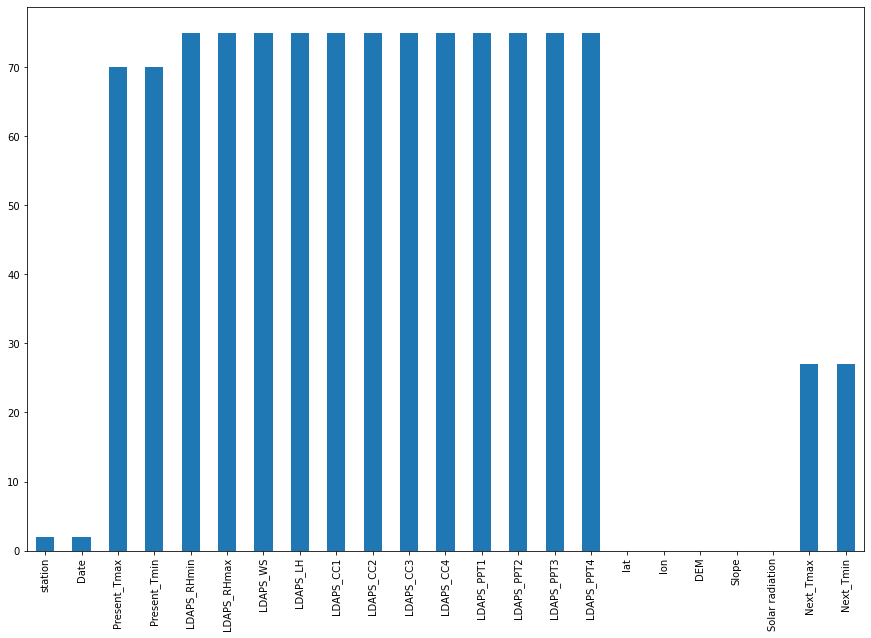

In [15]:
plt.figure(figsize=(15,10))
temp.isna().sum().plot.bar()

In [16]:
temp[temp['station'].isna()==True]

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,2.882580,-13.603212,0.000000,0.000000,...,0.000000,0.000000,0.000000,37.4562,126.826,12.370,0.098475,4329.520508,17.4,11.3
7751,NaN,NaN,37.6,29.9,98.524734,100.000153,21.857621,213.414006,0.967277,0.968353,...,21.621661,15.841235,16.655469,37.6450,127.135,212.335,5.178230,5992.895996,38.9,29.8


In [17]:
temp[(temp['lat']==37.4562)]

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
9,10.0,30-06-2013,31.6,20.5,56.651203,86.849632,6.518841,63.006075,0.348292,0.306255,...,0.000000,0.000000,0.000000,37.4562,126.955,208.507,5.178200,5893.608398,30.5,21.0
34,10.0,01-07-2013,30.0,21.1,68.921585,95.186226,13.526587,79.979037,0.564919,0.759817,...,5.555647,0.202442,2.291010,37.4562,126.955,208.507,5.178200,5887.616211,27.5,20.7
59,10.0,02-07-2013,27.5,22.5,55.519154,95.685928,10.068202,65.562053,0.232743,0.155972,...,0.000000,0.000000,0.000000,37.4562,126.955,208.507,5.178200,5880.977539,29.4,19.1
84,10.0,03-07-2013,28.7,19.3,72.975418,92.025421,9.380760,41.223285,0.133501,0.377683,...,0.000000,0.000000,0.054444,37.4562,126.955,208.507,5.178200,5873.690430,26.2,22.6
109,10.0,04-07-2013,26.1,23.5,46.404503,95.196129,6.862087,58.285455,0.710748,0.497042,...,0.002094,0.000000,0.000000,37.4562,126.955,208.507,5.178200,5865.756348,30.0,21.5
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7659,10.0,27-08-2017,25.6,16.6,57.107502,92.524139,8.484188,44.717952,0.448559,0.510073,...,0.000000,0.002126,1.538662,37.4562,126.955,208.507,5.178200,4495.878418,25.9,17.0
7684,10.0,28-08-2017,24.9,17.1,30.237392,93.662720,8.732646,81.410106,0.364741,0.073193,...,0.000000,0.000000,0.000000,37.4562,126.955,208.507,5.178200,4454.895508,22.6,16.9
7709,10.0,29-08-2017,21.8,16.9,45.357285,74.612885,4.949621,42.855331,0.611891,0.663251,...,0.000000,0.000000,0.000000,37.4562,126.955,208.507,5.178200,4413.500000,21.9,13.9
7734,10.0,30-08-2017,21.4,14.1,25.229910,86.536469,6.542819,69.655613,0.038369,0.044792,...,0.000000,0.000000,0.000000,37.4562,126.955,208.507,5.178200,4371.684570,26.2,15.0


In [18]:
temp[(temp['lat']==37.4562) & (temp['station'].isna()==True)]

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7750,NaN,NaN,20.0,11.3,19.794666,58.936283,2.88258,-13.603212,0.0,0.0,...,0.0,0.0,0.0,37.4562,126.826,12.37,0.098475,4329.520508,17.4,11.3


In [19]:
temp.iloc[7750,0]=10.00
temp.iloc[7750,1]=27-8-2017

In [20]:
temp[(temp['lat']==37.6450)]

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
3,4.0,30-06-2013,32.0,23.4,58.239788,96.483688,5.650050,65.727144,0.216372,0.226002,...,0.000000,0.000000,0.000000,37.645,127.022,45.716,2.53480,5856.964844,31.7,24.3
28,4.0,01-07-2013,31.0,24.5,74.534218,97.630035,12.586018,67.378635,0.583464,0.842180,...,9.090755,0.261195,3.192252,37.645,127.022,45.716,2.53480,5851.575195,27.9,21.5
53,4.0,02-07-2013,27.7,22.9,55.039024,96.981628,6.981138,81.486029,0.170104,0.152253,...,0.000000,0.000000,0.000000,37.645,127.022,45.716,2.53480,5845.616211,31.3,20.7
78,4.0,03-07-2013,30.7,20.9,71.985153,95.428375,7.632252,44.417797,0.095142,0.401594,...,0.000000,0.000000,0.021433,37.645,127.022,45.716,2.53480,5839.094727,28.4,23.3
103,4.0,04-07-2013,28.2,23.8,55.130985,98.723312,6.554396,69.937572,0.847869,0.419373,...,0.020794,0.000000,0.000000,37.645,127.022,45.716,2.53480,5832.032227,30.6,22.4
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7653,4.0,27-08-2017,25.9,18.9,68.553818,97.588509,6.307207,74.406010,0.451957,0.475426,...,0.000000,0.190059,9.078570,37.645,127.022,45.716,2.53480,4565.983887,26.3,17.9
7678,4.0,28-08-2017,25.7,17.9,38.505150,91.780807,13.894284,158.782252,0.344504,0.088125,...,0.000000,0.000000,0.000000,37.645,127.022,45.716,2.53480,4527.242188,23.7,17.8
7703,4.0,29-08-2017,23.5,18.3,54.885128,92.451164,6.894041,87.593592,0.589908,0.651899,...,0.000000,0.000000,0.000000,37.645,127.022,45.716,2.53480,4488.110840,23.0,16.5
7728,4.0,30-08-2017,22.6,16.7,38.991627,95.432045,5.608833,120.654731,0.056173,0.009785,...,0.000000,0.000000,0.000000,37.645,127.022,45.716,2.53480,4448.519043,26.9,17.0


In [21]:
temp[(temp['lat']==37.6450) & (temp['station'].isna()==True)]

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
7751,NaN,NaN,37.6,29.9,98.524734,100.000153,21.857621,213.414006,0.967277,0.968353,...,21.621661,15.841235,16.655469,37.645,127.135,212.335,5.17823,5992.895996,38.9,29.8


In [22]:
temp.iloc[7751,0]=4
temp.iloc[7751,1]=30-8-2017

station            AxesSubplot(0.125,0.852445;0.775x0.0275547)
Present_Tmax        AxesSubplot(0.125,0.81938;0.775x0.0275547)
Present_Tmin       AxesSubplot(0.125,0.786314;0.775x0.0275547)
LDAPS_RHmin        AxesSubplot(0.125,0.753248;0.775x0.0275547)
LDAPS_RHmax        AxesSubplot(0.125,0.720182;0.775x0.0275547)
LDAPS_WS           AxesSubplot(0.125,0.687117;0.775x0.0275547)
LDAPS_LH           AxesSubplot(0.125,0.654051;0.775x0.0275547)
LDAPS_CC1          AxesSubplot(0.125,0.620985;0.775x0.0275547)
LDAPS_CC2           AxesSubplot(0.125,0.58792;0.775x0.0275547)
LDAPS_CC3          AxesSubplot(0.125,0.554854;0.775x0.0275547)
LDAPS_CC4          AxesSubplot(0.125,0.521788;0.775x0.0275547)
LDAPS_PPT1         AxesSubplot(0.125,0.488723;0.775x0.0275547)
LDAPS_PPT2         AxesSubplot(0.125,0.455657;0.775x0.0275547)
LDAPS_PPT3         AxesSubplot(0.125,0.422591;0.775x0.0275547)
LDAPS_PPT4         AxesSubplot(0.125,0.389526;0.775x0.0275547)
lat                 AxesSubplot(0.125,0.35646;0.775x0.0

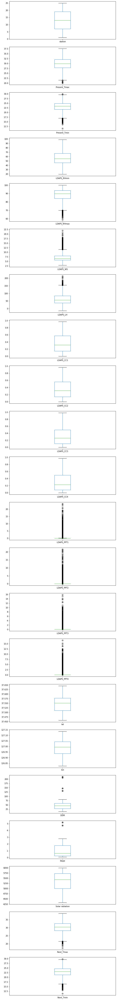

In [23]:
# checking the outliers
temp.plot(kind='box', subplots=True, layout=(23,1),figsize=(10,100))

In [24]:
temp['Present_Tmax'].replace(np.nan,temp['Present_Tmax'].median(),inplace=True)
temp['Present_Tmin'].replace(np.nan,temp['Present_Tmin'].median(),inplace=True)
temp['LDAPS_RHmin'].replace(np.nan,temp['LDAPS_RHmin'].mean(),inplace=True)
temp['LDAPS_RHmax'].replace(np.nan,temp['LDAPS_RHmax'].median(),inplace=True)
temp['LDAPS_WS'].replace(np.nan,temp['LDAPS_WS'].median(),inplace=True)
temp['LDAPS_LH'].replace(np.nan,temp['LDAPS_LH'].median(),inplace=True)
temp['LDAPS_CC1'].replace(np.nan,temp['LDAPS_CC1'].mean(),inplace=True)
temp['LDAPS_CC2'].replace(np.nan,temp['LDAPS_CC2'].mean(),inplace=True)
temp['LDAPS_CC3'].replace(np.nan,temp['LDAPS_CC3'].mean(),inplace=True)
temp['LDAPS_CC4'].replace(np.nan,temp['LDAPS_CC4'].mean(),inplace=True)
temp['LDAPS_PPT1'].replace(np.nan,temp['LDAPS_PPT1'].median(),inplace=True)
temp['LDAPS_PPT2'].replace(np.nan,temp['LDAPS_PPT2'].median(),inplace=True)
temp['LDAPS_PPT3'].replace(np.nan,temp['LDAPS_PPT3'].median(),inplace=True)
temp['LDAPS_PPT4'].replace(np.nan,temp['LDAPS_PPT4'].median(),inplace=True)
temp['Next_Tmax'].replace(np.nan,temp['Next_Tmax'].median(),inplace=True)
temp['Next_Tmin'].replace(np.nan,temp['Next_Tmin'].median(),inplace=True)

<AxesSubplot:>

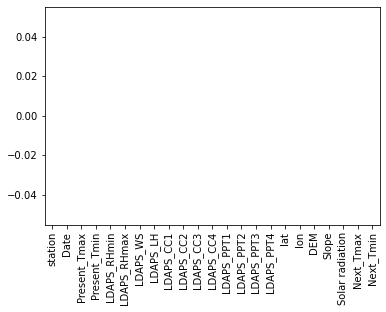

In [25]:
temp.isna().sum().plot.bar()

No null values

#### removing the outliers

In [26]:
# importing the required libraries
import warnings
warnings.filterwarnings('ignore')
from sklearn.preprocessing import LabelEncoder, OneHotEncoder
from scipy.stats import zscore

In [27]:
lb=LabelEncoder()

In [28]:
temp['Date']=temp['Date'].str.split('-')

In [29]:
temp['Day']=temp['Date'].str[0]
temp['month']=temp['Date'].str[1]
temp['year']=temp['Date'].str[2]

In [30]:
temp['Day']=lb.fit_transform(temp['Day'])
temp['month']=lb.fit_transform(temp['month'])
temp['year']=lb.fit_transform(temp['year'])

In [31]:
temp.drop(['Date'],axis=1,inplace=True)

In [32]:
z=np.abs(zscore(temp))

In [35]:
temp1=temp[(z<=4.5).all(axis=1)]

In [36]:
print("% Data loss",(temp.size-temp1.size)*100/temp.size)

% Data loss 5.018059855521156


The data i am lossing is less than 5% only when the Z value is less than 4.5

In [37]:
temp1.shape[1]

25

### Univarient analysis

array([[<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>],
       [<AxesSubplot:>]], dtype=object)

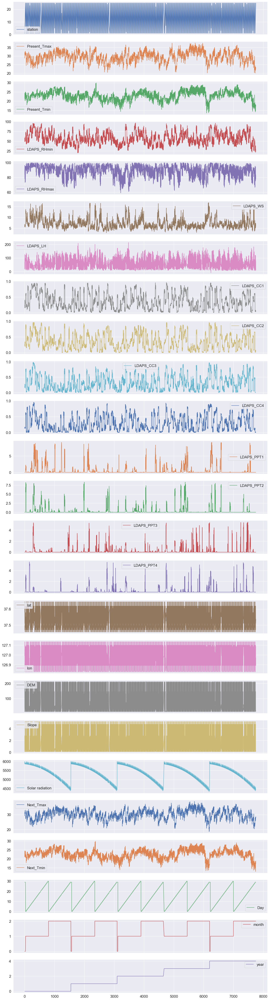

In [38]:
sns.set_theme(style='darkgrid',palette='deep',font_scale=1.5)
temp1.plot(kind='line',subplots=True,layout=(temp1.shape[1],1),figsize=(20,80))

### observations:
    1.25 station and data is collected from 25 stations collectively
    2.resent max temp and min temp are in range of 16 to 36
    3.relative humidity is varying in minimum to maximum
    4.cloud coverage is same in all the 4 intervals
    5.PPt values are slightly varying in all the 4 intervals
    6.solar radiation was followed a descending trend in all the 5 years data
    7.data is collected for same dates in all the 5 years

### Bivarient Analysis

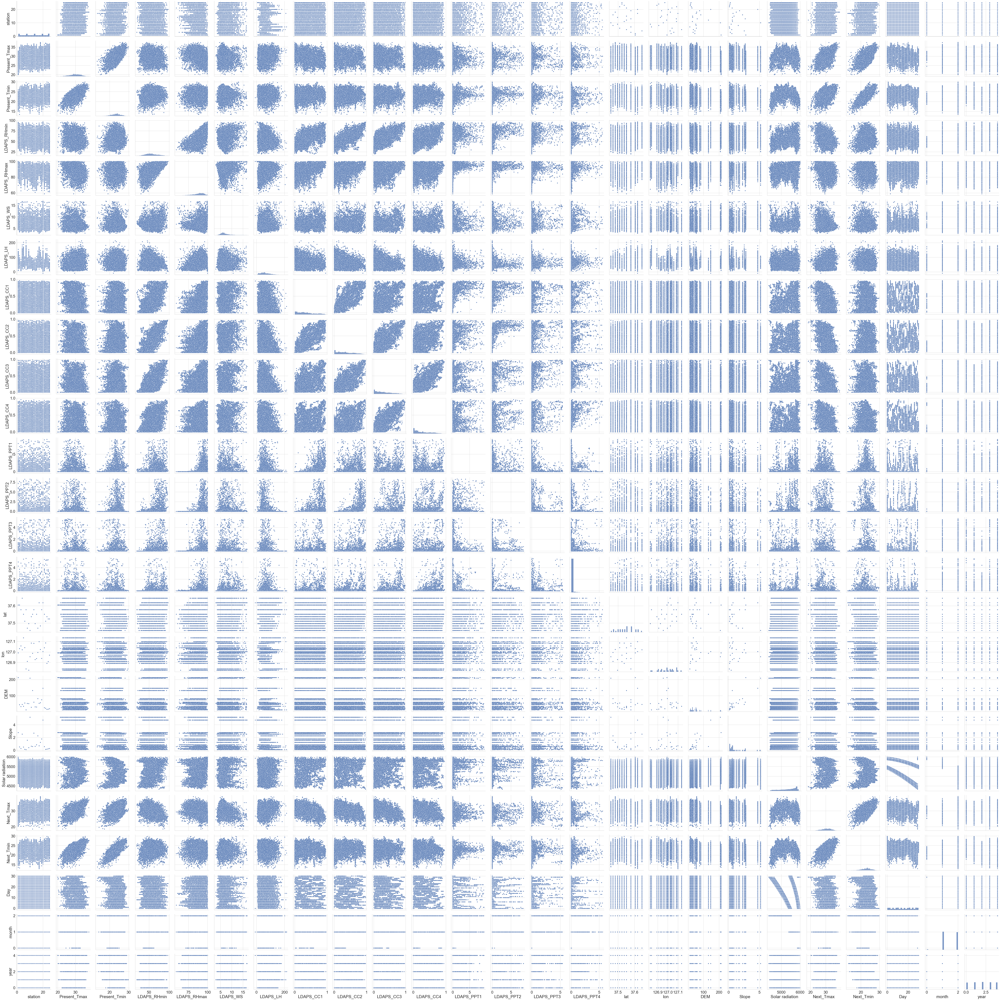

In [39]:
# lets draw the scatter plot between the future variables and the target variable
sns.set_theme(style='whitegrid',palette='deep',font_scale=2.5)
sns.pairplot(temp1, height=4, aspect=1)

### observations:
    1.increasing in the solar radiation will increase the day temperature
    2.increasing the colud cover increases the temperature
    3.increasing in precipitation also increases the temperature
    4.temperatures are increases with the consecutive years and months in all the 5 years data it follows the same trend 
    5.increasing slop, inclination alters the temperatures but it depends on the latitude and lon also
    6.in a specific lat, lon the temperature follows increasing trend with the days pasing on
    but for different lat, lon values of regions different temperatures are observed
    7.temperatures are increasing with the increase in latent heat
    8.the temperatures are incresing with the increasing the wind speeds
    9.with the increase in the relative humidity the temperatures are incresing
    

#### checking the correlation between the variables

In [ ]:
#lets check the correlation betweeen the variables
plt.figure(figsize=(60,80))
sns.heatmap(temp1.corr(),annot=True, cmap='PRGn', linewidths=2,linecolor='b')

### observations:
    there are few independent variables which are correlate with each other strongly
    lets check this out with VIF

In [41]:
import statsmodels.api as sm
from scipy import stats
from statsmodels.stats.outliers_influence import variance_inflation_factor

In [42]:
vf=pd.DataFrame()
vf['column_names']=temp1.columns
vf['VIF Values']=[variance_inflation_factor(temp1.values,n) for n in range(temp1.shape[1])]
vf.sort_values(by='VIF Values', ascending=False, inplace=True, ignore_index=True)
vf

,column_names,VIF Values
0,lat,694509.647890
1,lon,664693.504398
2,Solar radiation,5730.197369
3,Next_Tmin,415.655223
4,Next_Tmax,393.243474
5,LDAPS_RHmax,337.967623
6,Present_Tmin,326.739895
7,Present_Tmax,283.941658
8,month,265.310756
9,LDAPS_RHmin,67.834223


### observations:
        1.lat,log,solar_radiation has high VIF values and at the same time they are less correlated with my target columns
    we are going to drop them

In [43]:
temp2=temp1.drop(['lat','lon','Solar radiation'],axis=1)

### checking the skewness

In [44]:
temp2.skew()

station         0.000771
Present_Tmax   -0.303522
Present_Tmin   -0.362228
LDAPS_RHmin     0.317519
LDAPS_RHmax    -0.821567
LDAPS_WS        1.419244
LDAPS_LH        0.659671
LDAPS_CC1       0.524279
LDAPS_CC2       0.491300
LDAPS_CC3       0.700298
LDAPS_CC4       0.698360
LDAPS_PPT1      4.068363
LDAPS_PPT2      4.621844
LDAPS_PPT3      5.666764
LDAPS_PPT4      6.305706
DEM             1.736755
Slope           1.580502
Next_Tmax      -0.339075
Next_Tmin      -0.400988
Day            -0.015455
month          -0.174377
year           -0.007363
dtype: float64

### observaions:
    1.skewness is greater than +/-0.5 in 'LDAPS_RHmax','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC3','LDAPS_CC4',
    'LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4','DEM','Slope'.

In [45]:
l=['LDAPS_RHmax','LDAPS_WS','LDAPS_LH','LDAPS_CC1','LDAPS_CC3','LDAPS_CC4','LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4','DEM','Slope']

### reducing the skewness

In [46]:
#importing the power transform method from scipy stats library
from sklearn.preprocessing import power_transform

In [47]:
for i in l:
    d=np.array(temp2[i])
    temp2[i]=power_transform(d.reshape(-1,1),method='yeo-johnson')

In [48]:
temp2.skew()

station         0.000771
Present_Tmax   -0.303522
Present_Tmin   -0.362228
LDAPS_RHmin     0.317519
LDAPS_RHmax    -0.110752
LDAPS_WS        0.004216
LDAPS_LH       -0.016733
LDAPS_CC1       0.056092
LDAPS_CC2       0.491300
LDAPS_CC3       0.092590
LDAPS_CC4       0.133475
LDAPS_PPT1      1.514771
LDAPS_PPT2      1.736326
LDAPS_PPT3      1.911109
LDAPS_PPT4      2.183455
DEM             0.040061
Slope           0.235695
Next_Tmax      -0.339075
Next_Tmin      -0.400988
Day            -0.015455
month          -0.174377
year           -0.007363
dtype: float64

In [49]:
#still we have skew in LDAPS_PPt1 to PPt4 we can drop them
temp3=temp2.drop(['LDAPS_PPT1','LDAPS_PPT2','LDAPS_PPT3','LDAPS_PPT4'],axis=1)

In [51]:
temp3.skew()

station         0.000771
Present_Tmax   -0.303522
Present_Tmin   -0.362228
LDAPS_RHmin     0.317519
LDAPS_RHmax    -0.110752
LDAPS_WS        0.004216
LDAPS_LH       -0.016733
LDAPS_CC1       0.056092
LDAPS_CC2       0.491300
LDAPS_CC3       0.092590
LDAPS_CC4       0.133475
DEM             0.040061
Slope           0.235695
Next_Tmax      -0.339075
Next_Tmin      -0.400988
Day            -0.015455
month          -0.174377
year           -0.007363
dtype: float64

### Scaling

In [52]:
# after the skewness removal its time for scaling
# scaling: reducing the magnitude and nullfying the units of an variable is called scaling
# importing the required libraries
from sklearn.preprocessing import MinMaxScaler, StandardScaler

### splitting the data dependent variables and independent variables

In [53]:
temp3.head(2)

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,DEM,Slope,Next_Tmax,Next_Tmin,Day,month,year
0,1.0,28.7,21.4,58.255688,0.319556,0.132641,0.335006,-0.363680,0.203896,-0.497055,-0.543595,1.838789,1.32327,29.1,21.2,29,0,0
1,2.0,31.9,21.6,52.263397,0.232469,-0.596538,-0.179449,-0.403809,0.251771,-0.509984,-0.563276,0.064953,-0.37627,30.5,22.5,29,0,0


In [54]:
x=temp3.iloc[:,[0,1,2,3,4,5,6,7,8,9,10,11,12,15,16,17]]

In [55]:
y1=temp3.iloc[:,13]
y2=temp3.iloc[:,14]

In [56]:
scale=MinMaxScaler()

In [57]:
for i in x.columns:
    d=np.array(x[i])
    scale.fit(d.reshape(-1,1))
    x[i]=scale.transform(d.reshape(-1,1))
    

### Hyper Perameter Tuning

Hyperparameter tuning is choosing a set of optimal hyperparameters for a learning algorithm. A hyperparameter is a model argument whose value is set before the learning process begins

In [68]:
# importing the required libraries
from sklearn.metrics import mean_squared_error,mean_absolute_error
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
from sklearn.metrics import r2_score
from sklearn.model_selection import cross_val_score
from sklearn.ensemble import RandomForestRegressor, AdaBoostRegressor
from sklearn.tree import DecisionTreeRegressor
from sklearn.model_selection import GridSearchCV
rf, ab,dt,lr=RandomForestRegressor(), AdaBoostRegressor(), DecisionTreeRegressor(), LinearRegression()

#### Case-I(Next_Tmax)

In [72]:

#creating perameters
model_par={'DecisionTreeRegressor':{'model':dt,'param':{'criterion' : ["mse", "friedman_mse", "mae", "poisson"],'splitter':['best','random']}},
           'RandomForestRegressor':{'model':rf,'param':{'n_estimators':[100,120,150],'criterion':['mse', 'mae'],'max_features':['auto','sqrt','log2']}},
           'AdaBoostRegressor':{'model':ab,'param':{'loss':['linear', 'square', 'exponential']}},
           'LinearRegression':{'model':lr,'param':{'fit_intercept':[True],'normalize':[True]}}
          }
scores=[]
for model_name, mp in model_par.items():
    model_selection=GridSearchCV(estimator=mp['model'],param_grid=mp['param'],cv=5,return_train_score=False)
    model_selection.fit(x,y1)
    scores.append({'model':model_name,'best_score':model_selection.best_score_,'best_params':model_selection.best_params_})
scores

[{'model': 'DecisionTreeRegressor',
  'best_score': 0.0629528435887233,
  'best_params': {'criterion': 'mse', 'splitter': 'random'}},
 {'model': 'RandomForestRegressor',
  'best_score': 0.5490869183106932,
  'best_params': {'criterion': 'mse',
   'max_features': 'sqrt',
   'n_estimators': 120}},
 {'model': 'AdaBoostRegressor',
  'best_score': 0.5347463713584425,
  'best_params': {'loss': 'square'}},
 {'model': 'LinearRegression',
  'best_score': 0.551233488786162,
  'best_params': {'fit_intercept': True, 'normalize': True}}]

### model selection

from the above gridsearch cv it is clear that the RandomForestRegression and LinearRegressor are working good for the data

In [72]:
lr=LinearRegression(fit_intercept=True,normalize=True)

In [105]:
I=[]
score=[]
ma=[]
ms=[]
r2=[]
cv=[]

for i in range(1,500):
        xtrain,xtest,ytrain,ytest=train_test_split(x,y1,test_size=0.3,random_state=i)
        lr.fit(xtrain,ytrain)
        tr=lr.score(xtrain,ytrain)
        te=lr.score(xtest,ytest)
        pre=lr.predict(xtest)
        mar=mean_absolute_error(ytest,pre)
        mse=np.sqrt(mean_squared_error(ytest,pre))
        CV=cross_val_score(lr,x,y1,cv=4).mean()*100
        r=r2_score(ytest,pre)
        I.append(i)
        score.append(te)
        ma.append(mar)
        ms.append(mse)
        r2.append(r)
        cv.append(CV)
values=pd.DataFrame({'accuracy':score,'r2_score':r2,'r_state':I,'error':ms,'CV_score':cv})
values.sort_values(by='accuracy', ascending=False, inplace=True,ignore_index=True)
print('at random state',round(values.loc[0][2],0),'the model having the highest accuracy of',round(values.loc[0][0]*100,2))
print('Mean Square Error Value',values.loc[0][3],'CV_Score',values.loc[0][4])

at random state 78.0 the model having the highest accuracy of 67.67
Mean Square Error Value 1.7702968974656528 CV_Score 55.63053162597943


In [126]:
### Model saving
import pickle
filename='Tmax.pkl'
pickle.dump(lr,open(filename,'wb'))

#### Case-II(Next_Tmin)

In [73]:
rf, ab,dt,lr=RandomForestRegressor(), AdaBoostRegressor(), DecisionTreeRegressor(), LinearRegression()
#creating perameters
model_par={'DecisionTreeRegressor':{'model':dt,'param':{'criterion' : ["mse", "friedman_mse", "mae", "poisson"],'splitter':['best','random']}},
           'RandomForestRegressor':{'model':rf,'param':{'n_estimators':[100,120,150],'criterion':['mse', 'mae'],'max_features':['auto','sqrt','log2']}},
           'AdaBoostRegressor':{'model':ab,'param':{'loss':['linear', 'square', 'exponential']}},
           'LinearRegression':{'model':lr,'param':{'fit_intercept':[True],'normalize':[True]}}
          }
scores=[]
for model_name, mp in model_par.items():
    model_selection=GridSearchCV(estimator=mp['model'],param_grid=mp['param'],cv=5,return_train_score=False)
    model_selection.fit(x,y2)
    scores.append({'model':model_name,'best_score':model_selection.best_score_,'best_params':model_selection.best_params_})
scores

[{'model': 'DecisionTreeRegressor',
  'best_score': 0.1939413961567698,
  'best_params': {'criterion': 'friedman_mse', 'splitter': 'best'}},
 {'model': 'RandomForestRegressor',
  'best_score': 0.5956474884180876,
  'best_params': {'criterion': 'mae',
   'max_features': 'log2',
   'n_estimators': 150}},
 {'model': 'AdaBoostRegressor',
  'best_score': 0.580560319289663,
  'best_params': {'loss': 'linear'}},
 {'model': 'LinearRegression',
  'best_score': 0.5871598469858322,
  'best_params': {'fit_intercept': True, 'normalize': True}}]

### model selection

from the above gridsearch cv it is clear that the RandomForestRegression and Linear Regressor are working good for the data

In [124]:
lr=LinearRegression(fit_intercept=True,normalize=True)

In [125]:
I=[]
score=[]
ma=[]
ms=[]
r2=[]
cv=[]

for i in range(1,500):
        xtrain,xtest,ytrain,ytest=train_test_split(x,y1,test_size=0.4,random_state=i)
        lr.fit(xtrain,ytrain)
        tr=lr.score(xtrain,ytrain)
        te=lr.score(xtest,ytest)
        pre=lr.predict(xtest)
        mar=mean_absolute_error(ytest,pre)
        mse=np.sqrt(mean_squared_error(ytest,pre))
        CV=cross_val_score(lr,x,y1,cv=4).mean()*100
        r=r2_score(ytest,pre)
        I.append(i)
        score.append(te)
        ma.append(mar)
        ms.append(mse)
        r2.append(r)
        cv.append(CV)
values=pd.DataFrame({'accuracy':score,'r2_score':r2,'r_state':I,'error':ms,'CV_score':cv})
values.sort_values(by='accuracy', ascending=False, inplace=True,ignore_index=True)
print('at random state',round(values.loc[0][2],0),'the model having the highest accuracy of',round(values.loc[0][0]*100,2))
print('Mean Square Error Value',values.loc[0][3],'CV_Score',values.loc[0][4])

at random state 293.0 the model having the highest accuracy of 66.38
Mean Square Error Value 1.7961194976667738 CV_Score 55.63053162597943


In [127]:
### Model saving
import pickle
filename='Tmin.pkl'
pickle.dump(lr,open(filename,'wb'))